# **Pre-trained VGG-16 model trained on the KDEF dataset with input image resolution of 112x112.**

In [1]:
!pip install tensorboardX

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 2.3 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
from torch.utils.data import Dataset
import os
import copy
from tensorboardX import SummaryWriter
from PIL import Image
import torchvision.transforms as transforms
import random
plt.ion()   # interactive mode
%matplotlib inline

In [3]:
# Set fixed seed for reproducibility
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [4]:
from zipfile import ZipFile
import os

zip_path = '/content/KEDF_downsample_112x112.zip'

extract_to = '/content'

os.makedirs(extract_to, exist_ok=True)

with ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f'✅ Files extracted to: {extract_to}')

✅ Files extracted to: /content


In [5]:
import os

classes = {
    "AF": 0, "AN": 1, "DI": 2, "HA": 3, "NE": 4, "SA": 5, "SU": 6
}

root='/content/KEDF_downsample_112x112'
invalid_files = []

for path, subdirs, files in os.walk(root):
    for name in files:
        if len(name) >= 6:
            emotion_code = name[4:6]
            if emotion_code not in classes:
                invalid_files.append(os.path.join(path, name))

# Print the problematic files
print("Found {} problematic files:".format(len(invalid_files)))
for file in invalid_files:
    print(file)

Found 0 problematic files:


In [6]:
class KDEFDataset(Dataset):
    def __init__(self, root='/content/KEDF_downsample_112x112', transforms_=None, idx=[]):
        self.transform = transforms_
        self.files = []

        for path, subdirs, files in os.walk(root):
            for name in files:
                self.files.append(os.path.join(path, name))

        self.files =  [self.files[i] for i in idx]
        self.classes = {
             "AF":0,
             "AN":1,
             "DI":2,
             "HA":3,
             "NE":4,
             "SA":5,
             "SU":6
        }
        for f in self.files:
          name = f.split('/')[-1]
          emotion_code = name[4:6]
          if emotion_code not in self.classes:
              print(f"Invalid file: {f} (code: {emotion_code})")

        for index in range(4900):
            filepath = self.files[index % len(self.files)]
            filename = filepath.split('/')[-1]
            if filename[4:6] not in self.classes:
                print(filepath)

    def __getitem__(self, index):
        filepath = self.files[index % len(self.files)]

        filename = filepath.split('/')[-1]
        img = self.transform(Image.open(filepath))
        label = self.classes[filename[4:6]]

        return img, label

    def __len__(self):
        return len(self.files)

Load Data
---------


In [7]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
    'val': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
}

idx = np.random.permutation(4900)
idx = {'val': idx[0:490], 'train': idx[490:]}

g = torch.Generator()
g.manual_seed(42)

dataloaders = {
    x: torch.utils.data.DataLoader(
        KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
        batch_size=32,
        shuffle=True,
        generator=g
    )
    for x in ['train', 'val']
}

dataset_sizes = {x: len(idx[x]) for x in ['train', 'val']}
class_names = 7

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Visualize a few images


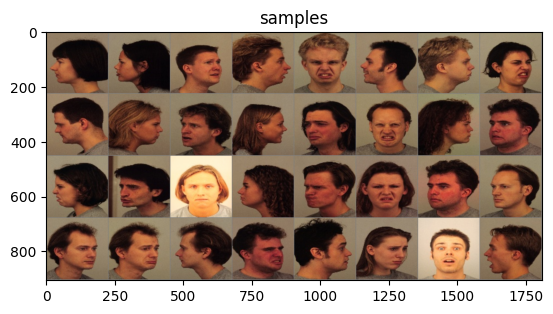

In [8]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title='samples')

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [9]:
from tqdm import tqdm

def train_model(model, criterion, optimizer, scheduler, dataloaders, writer=None, i=0,  num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in tqdm(dataloaders[phase]):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))


            writer.add_scalar(phase+"/loss", epoch_loss, epoch)
            writer.add_scalar(phase+"/acc", epoch_acc, epoch)


            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, best_acc

Visualizing the model predictions

In [10]:
import imageio
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

def visualize_model_misclassified(model, dataloader, class_names, save_dir='misclassified', num_images=15, columns=3):
    os.makedirs(save_dir, exist_ok=True)
    was_training = model.training
    model.eval()
    images_so_far = 0
    rows = (num_images + columns - 1) // columns
    fig, axes = plt.subplots(rows, columns, figsize=(columns * 4, rows * 4))
    axes = axes.flatten()

    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                if preds[j] != labels[j]:
                    if images_so_far >= num_images:
                        break

                    # --- Display in grid ---
                    ax = axes[images_so_far]
                    ax.axis('off')
                    ax.set_title(f'Pred: {class_names[int(preds[j])]},\nTrue: {class_names[int(labels[j])]}', fontsize=9)
                    imshow(inputs.cpu().data[j], ax=ax)

                    # --- Save image with overlay text ---
                    img = inputs[j].cpu().numpy().transpose(1, 2, 0)
                    img = (img * 0.5 + 0.5) * 255
                    img = img.astype(np.uint8)
                    img_pil = Image.fromarray(img)

                    draw = ImageDraw.Draw(img_pil)
                    font = ImageFont.load_default()
                    text = f'Predicted: {class_names[int(preds[j])]} | True: {class_names[int(labels[j])]}'
                    draw.rectangle([10, 10, 280, 25], fill=(255, 255, 255))
                    draw.text((10, 10), text, font=font, fill=(0, 0, 0))

                    img_pil.save(f'{save_dir}/misclassified_{images_so_far + 1}.jpg')

                    images_so_far += 1

    for k in range(images_so_far, len(axes)):
        axes[k].axis('off')

    plt.tight_layout()
    plt.show()
    model.train(mode=was_training)


def imshow(inp, ax=None, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    if ax is None:
        plt.imshow(inp)
    else:
        ax.imshow(inp)
    if title is not None:
        ax.set_title(title)


Finetuning the convnet
----------------------

Load a pretrained model and reset final fully connected layer.




/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:227: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn(


Epoch 0/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.73it/s]


train Loss: 1.8244 Acc: 0.2397


100%|██████████| 16/16 [00:01<00:00, 14.93it/s]


val Loss: 1.3795 Acc: 0.4469

Epoch 1/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.77it/s]


train Loss: 1.2118 Acc: 0.5204


100%|██████████| 16/16 [00:01<00:00, 14.65it/s]


val Loss: 0.7764 Acc: 0.7265

Epoch 2/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.77it/s]


train Loss: 0.7803 Acc: 0.7014


100%|██████████| 16/16 [00:01<00:00, 14.86it/s]


val Loss: 0.6787 Acc: 0.7224

Epoch 3/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.78it/s]


train Loss: 0.6162 Acc: 0.7710


100%|██████████| 16/16 [00:01<00:00, 14.80it/s]


val Loss: 0.4605 Acc: 0.8388

Epoch 4/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.79it/s]


train Loss: 0.4413 Acc: 0.8404


100%|██████████| 16/16 [00:01<00:00, 14.99it/s]


val Loss: 0.4473 Acc: 0.8265

Epoch 5/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.75it/s]


train Loss: 0.2635 Acc: 0.9127


100%|██████████| 16/16 [00:01<00:00, 14.98it/s]


val Loss: 0.3051 Acc: 0.8878

Epoch 6/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.77it/s]


train Loss: 0.2192 Acc: 0.9256


100%|██████████| 16/16 [00:01<00:00, 14.74it/s]


val Loss: 0.3011 Acc: 0.8980

Epoch 7/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.78it/s]


train Loss: 0.2049 Acc: 0.9290


100%|██████████| 16/16 [00:01<00:00, 14.57it/s]


val Loss: 0.2786 Acc: 0.9061

Epoch 8/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.82it/s]


train Loss: 0.1862 Acc: 0.9397


100%|██████████| 16/16 [00:01<00:00, 14.84it/s]


val Loss: 0.2803 Acc: 0.9020

Epoch 9/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.81it/s]


train Loss: 0.1699 Acc: 0.9429


100%|██████████| 16/16 [00:01<00:00, 14.62it/s]


val Loss: 0.2895 Acc: 0.8857

Epoch 10/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.78it/s]


train Loss: 0.1630 Acc: 0.9417


100%|██████████| 16/16 [00:01<00:00, 14.88it/s]


val Loss: 0.2587 Acc: 0.9143

Epoch 11/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.80it/s]


train Loss: 0.1409 Acc: 0.9533


100%|██████████| 16/16 [00:01<00:00, 13.82it/s]


val Loss: 0.2542 Acc: 0.9122

Epoch 12/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.78it/s]


train Loss: 0.1402 Acc: 0.9537


100%|██████████| 16/16 [00:01<00:00, 14.97it/s]


val Loss: 0.2509 Acc: 0.9122

Epoch 13/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.81it/s]


train Loss: 0.1354 Acc: 0.9569


100%|██████████| 16/16 [00:01<00:00, 14.80it/s]


val Loss: 0.2549 Acc: 0.9082

Epoch 14/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.82it/s]


train Loss: 0.1366 Acc: 0.9567


100%|██████████| 16/16 [00:01<00:00, 15.08it/s]


val Loss: 0.2526 Acc: 0.9102

Epoch 15/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.80it/s]


train Loss: 0.1333 Acc: 0.9574


100%|██████████| 16/16 [00:01<00:00, 14.79it/s]


val Loss: 0.2533 Acc: 0.9143

Epoch 16/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.73it/s]


train Loss: 0.1335 Acc: 0.9549


100%|██████████| 16/16 [00:01<00:00, 15.04it/s]


val Loss: 0.2515 Acc: 0.9122

Epoch 17/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.79it/s]


train Loss: 0.1286 Acc: 0.9592


100%|██████████| 16/16 [00:01<00:00, 14.79it/s]


val Loss: 0.2517 Acc: 0.9122

Epoch 18/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.78it/s]


train Loss: 0.1332 Acc: 0.9592


100%|██████████| 16/16 [00:01<00:00, 14.85it/s]


val Loss: 0.2518 Acc: 0.9122

Epoch 19/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.79it/s]


train Loss: 0.1299 Acc: 0.9590


100%|██████████| 16/16 [00:01<00:00, 14.75it/s]


val Loss: 0.2519 Acc: 0.9163

Training complete in 5m 36s
Best val Acc: 0.916327
Showing misclassified examples for fold 0...


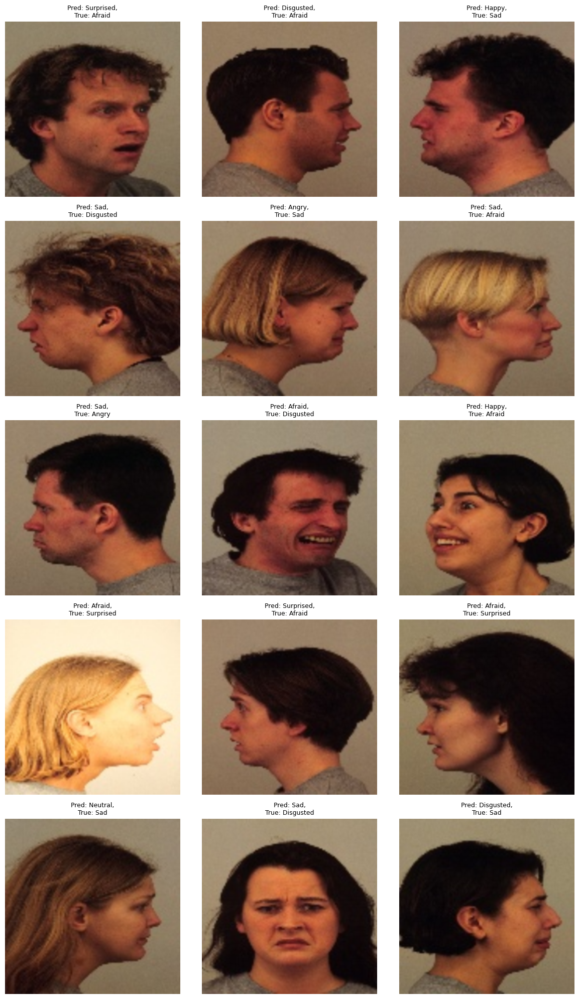




------------------------------------
 Accuracies  [0.916326530612245]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.48it/s]


train Loss: 1.8163 Acc: 0.2515


100%|██████████| 16/16 [00:01<00:00, 14.98it/s]


val Loss: 1.4028 Acc: 0.4306

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 1.1763 Acc: 0.5379


100%|██████████| 16/16 [00:01<00:00, 14.89it/s]


val Loss: 0.9181 Acc: 0.6551

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.7656 Acc: 0.7000


100%|██████████| 16/16 [00:01<00:00, 14.29it/s]


val Loss: 0.7556 Acc: 0.6959

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.5922 Acc: 0.7832


100%|██████████| 16/16 [00:01<00:00, 14.67it/s]


val Loss: 0.6430 Acc: 0.7510

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.46it/s]


train Loss: 0.4580 Acc: 0.8290


100%|██████████| 16/16 [00:01<00:00, 14.64it/s]


val Loss: 0.4508 Acc: 0.8286

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.50it/s]


train Loss: 0.2578 Acc: 0.9093


100%|██████████| 16/16 [00:01<00:00, 14.73it/s]


val Loss: 0.3204 Acc: 0.8714

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.2140 Acc: 0.9270


100%|██████████| 16/16 [00:01<00:00, 14.89it/s]


val Loss: 0.2990 Acc: 0.8816

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.1958 Acc: 0.9315


100%|██████████| 16/16 [00:01<00:00, 14.26it/s]


val Loss: 0.3005 Acc: 0.8878

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.1752 Acc: 0.9420


100%|██████████| 16/16 [00:01<00:00, 14.92it/s]


val Loss: 0.2936 Acc: 0.8837

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1732 Acc: 0.9399


100%|██████████| 16/16 [00:01<00:00, 14.24it/s]


val Loss: 0.2790 Acc: 0.8898

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.1511 Acc: 0.9478


100%|██████████| 16/16 [00:01<00:00, 14.58it/s]


val Loss: 0.2818 Acc: 0.8939

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.50it/s]


train Loss: 0.1340 Acc: 0.9576


100%|██████████| 16/16 [00:01<00:00, 14.34it/s]


val Loss: 0.2683 Acc: 0.8980

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1363 Acc: 0.9546


100%|██████████| 16/16 [00:01<00:00, 14.76it/s]


val Loss: 0.2712 Acc: 0.8898

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1320 Acc: 0.9551


100%|██████████| 16/16 [00:01<00:00, 14.10it/s]


val Loss: 0.2673 Acc: 0.8980

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.1297 Acc: 0.9562


100%|██████████| 16/16 [00:01<00:00, 14.13it/s]


val Loss: 0.2649 Acc: 0.8980

Epoch 15/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.65it/s]


train Loss: 0.1273 Acc: 0.9603


100%|██████████| 16/16 [00:01<00:00, 14.68it/s]


val Loss: 0.2641 Acc: 0.8939

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.1334 Acc: 0.9574


100%|██████████| 16/16 [00:01<00:00, 13.70it/s]


val Loss: 0.2712 Acc: 0.8959

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1239 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 14.69it/s]


val Loss: 0.2701 Acc: 0.8959

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1212 Acc: 0.9610


100%|██████████| 16/16 [00:01<00:00, 14.32it/s]


val Loss: 0.2693 Acc: 0.8939

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1245 Acc: 0.9596


100%|██████████| 16/16 [00:01<00:00, 14.34it/s]


val Loss: 0.2679 Acc: 0.8918

Training complete in 5m 45s
Best val Acc: 0.897959
Showing misclassified examples for fold 1...


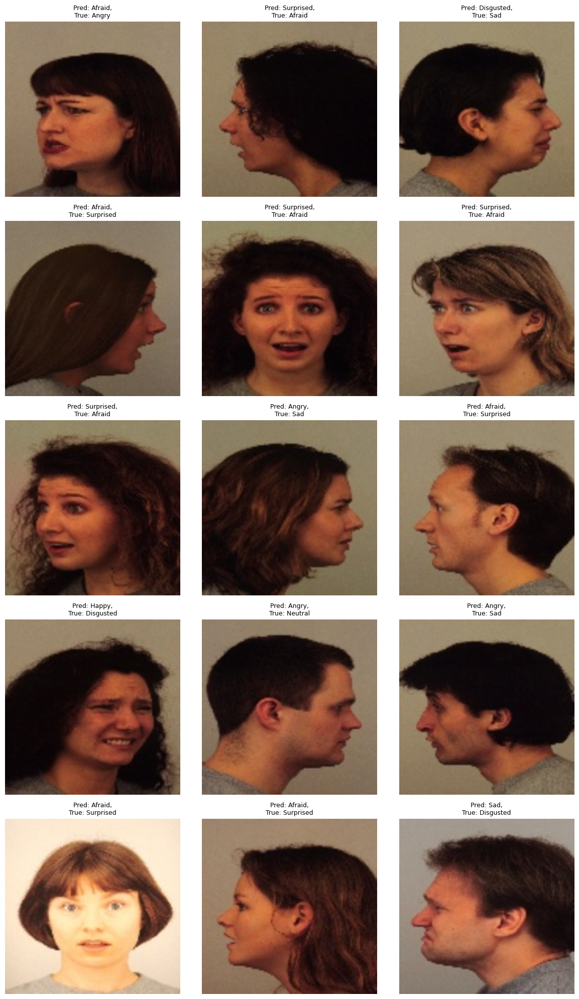




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.39it/s]


train Loss: 1.8336 Acc: 0.2440


100%|██████████| 16/16 [00:01<00:00, 14.73it/s]


val Loss: 1.4012 Acc: 0.4306

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 1.1820 Acc: 0.5304


100%|██████████| 16/16 [00:01<00:00, 13.30it/s]


val Loss: 0.7898 Acc: 0.6959

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.7981 Acc: 0.6905


100%|██████████| 16/16 [00:01<00:00, 14.52it/s]


val Loss: 0.5788 Acc: 0.7755

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.50it/s]


train Loss: 0.5875 Acc: 0.7726


100%|██████████| 16/16 [00:01<00:00, 13.30it/s]


val Loss: 0.4864 Acc: 0.8245

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.4499 Acc: 0.8390


100%|██████████| 16/16 [00:01<00:00, 13.69it/s]


val Loss: 0.4370 Acc: 0.8347

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.42it/s]


train Loss: 0.2830 Acc: 0.8977


100%|██████████| 16/16 [00:01<00:00, 14.92it/s]


val Loss: 0.3279 Acc: 0.8837

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.46it/s]


train Loss: 0.2343 Acc: 0.9213


100%|██████████| 16/16 [00:01<00:00, 14.81it/s]


val Loss: 0.3236 Acc: 0.8837

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.43it/s]


train Loss: 0.2165 Acc: 0.9193


100%|██████████| 16/16 [00:01<00:00, 14.28it/s]


val Loss: 0.2984 Acc: 0.8939

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.1931 Acc: 0.9322


100%|██████████| 16/16 [00:01<00:00, 14.95it/s]


val Loss: 0.2978 Acc: 0.8959

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1817 Acc: 0.9381


100%|██████████| 16/16 [00:01<00:00, 14.57it/s]


val Loss: 0.2926 Acc: 0.9020

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.28it/s]


train Loss: 0.1634 Acc: 0.9465


100%|██████████| 16/16 [00:01<00:00, 14.33it/s]


val Loss: 0.2824 Acc: 0.8918

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.1418 Acc: 0.9565


100%|██████████| 16/16 [00:01<00:00, 14.52it/s]


val Loss: 0.2705 Acc: 0.9082

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1446 Acc: 0.9524


100%|██████████| 16/16 [00:01<00:00, 13.89it/s]


val Loss: 0.2688 Acc: 0.9061

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.36it/s]


train Loss: 0.1420 Acc: 0.9528


100%|██████████| 16/16 [00:01<00:00, 13.64it/s]


val Loss: 0.2691 Acc: 0.9122

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.45it/s]


train Loss: 0.1372 Acc: 0.9551


100%|██████████| 16/16 [00:01<00:00, 14.39it/s]


val Loss: 0.2680 Acc: 0.9122

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1443 Acc: 0.9537


100%|██████████| 16/16 [00:01<00:00, 14.68it/s]


val Loss: 0.2674 Acc: 0.9061

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1429 Acc: 0.9524


100%|██████████| 16/16 [00:01<00:00, 13.83it/s]


val Loss: 0.2663 Acc: 0.9082

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.1322 Acc: 0.9592


100%|██████████| 16/16 [00:01<00:00, 13.96it/s]


val Loss: 0.2669 Acc: 0.9102

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1368 Acc: 0.9578


100%|██████████| 16/16 [00:01<00:00, 13.92it/s]


val Loss: 0.2666 Acc: 0.9102

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.46it/s]


train Loss: 0.1315 Acc: 0.9594


100%|██████████| 16/16 [00:01<00:00, 14.92it/s]


val Loss: 0.2665 Acc: 0.9102

Training complete in 5m 49s
Best val Acc: 0.912245
Showing misclassified examples for fold 2...


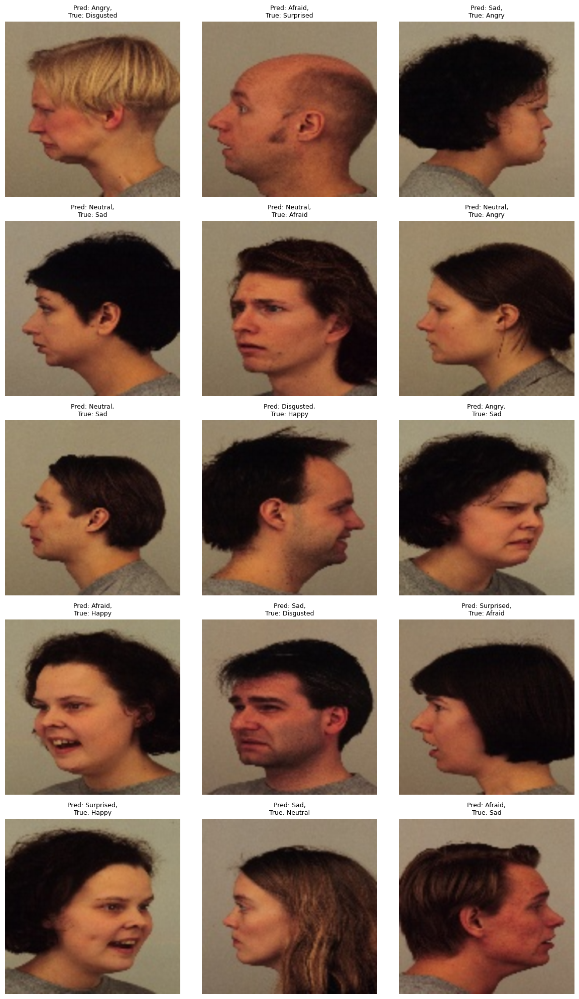




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 1.8446 Acc: 0.2288


100%|██████████| 16/16 [00:01<00:00, 14.44it/s]


val Loss: 1.3928 Acc: 0.4388

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 1.1465 Acc: 0.5456


100%|██████████| 16/16 [00:01<00:00, 14.71it/s]


val Loss: 0.8266 Acc: 0.6959

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.7484 Acc: 0.7041


100%|██████████| 16/16 [00:01<00:00, 14.02it/s]


val Loss: 0.6965 Acc: 0.7020

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.6009 Acc: 0.7707


100%|██████████| 16/16 [00:01<00:00, 13.24it/s]


val Loss: 0.4806 Acc: 0.8265

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.4376 Acc: 0.8460


100%|██████████| 16/16 [00:01<00:00, 14.51it/s]


val Loss: 0.3920 Acc: 0.8796

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.41it/s]


train Loss: 0.2289 Acc: 0.9209


100%|██████████| 16/16 [00:01<00:00, 13.53it/s]


val Loss: 0.3308 Acc: 0.9000

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.39it/s]


train Loss: 0.2038 Acc: 0.9277


100%|██████████| 16/16 [00:01<00:00, 14.22it/s]


val Loss: 0.3393 Acc: 0.8796

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.39it/s]


train Loss: 0.1742 Acc: 0.9415


100%|██████████| 16/16 [00:01<00:00, 14.55it/s]


val Loss: 0.3213 Acc: 0.9020

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.1689 Acc: 0.9422


100%|██████████| 16/16 [00:01<00:00, 13.86it/s]


val Loss: 0.3186 Acc: 0.8939

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.1551 Acc: 0.9460


100%|██████████| 16/16 [00:01<00:00, 13.98it/s]


val Loss: 0.3091 Acc: 0.8918

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1502 Acc: 0.9469


100%|██████████| 16/16 [00:01<00:00, 14.69it/s]


val Loss: 0.2984 Acc: 0.9082

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.48it/s]


train Loss: 0.1301 Acc: 0.9574


100%|██████████| 16/16 [00:01<00:00, 14.00it/s]


val Loss: 0.2990 Acc: 0.9102

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.1245 Acc: 0.9583


100%|██████████| 16/16 [00:01<00:00, 14.08it/s]


val Loss: 0.3057 Acc: 0.9061

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.39it/s]


train Loss: 0.1202 Acc: 0.9601


100%|██████████| 16/16 [00:01<00:00, 14.58it/s]


val Loss: 0.3005 Acc: 0.9061

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.44it/s]


train Loss: 0.1156 Acc: 0.9653


100%|██████████| 16/16 [00:01<00:00, 14.24it/s]


val Loss: 0.2998 Acc: 0.9061

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.1167 Acc: 0.9644


100%|██████████| 16/16 [00:01<00:00, 14.84it/s]


val Loss: 0.3016 Acc: 0.9082

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.1152 Acc: 0.9619


100%|██████████| 16/16 [00:01<00:00, 13.82it/s]


val Loss: 0.2938 Acc: 0.9102

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1138 Acc: 0.9644


100%|██████████| 16/16 [00:01<00:00, 14.33it/s]


val Loss: 0.2951 Acc: 0.9102

Epoch 18/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.63it/s]


train Loss: 0.1156 Acc: 0.9635


100%|██████████| 16/16 [00:01<00:00, 14.07it/s]


val Loss: 0.2965 Acc: 0.9102

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1159 Acc: 0.9649


100%|██████████| 16/16 [00:01<00:00, 14.19it/s]


val Loss: 0.2974 Acc: 0.9102

Training complete in 5m 48s
Best val Acc: 0.910204
Showing misclassified examples for fold 3...


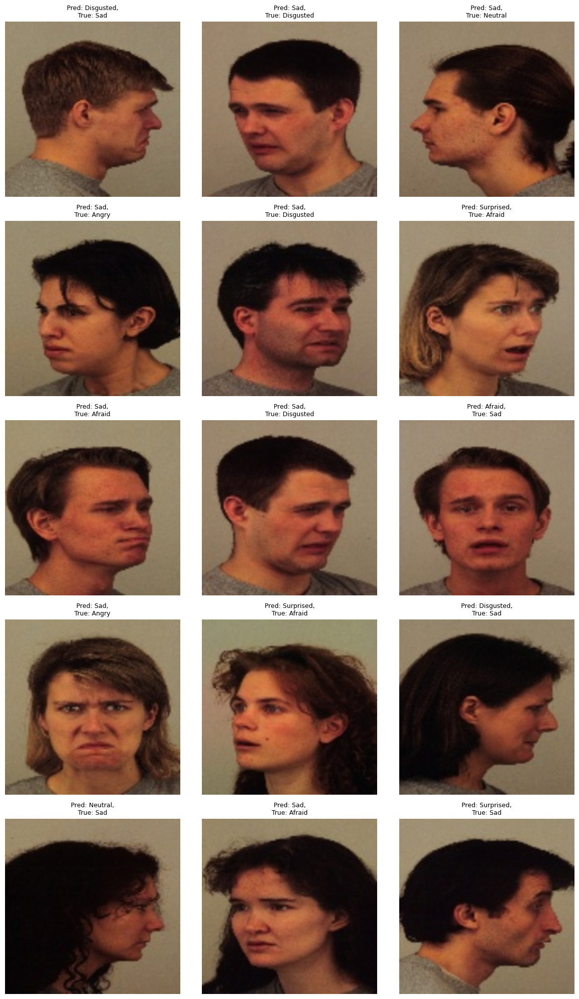




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 1.8468 Acc: 0.2370


100%|██████████| 16/16 [00:01<00:00, 13.57it/s]


val Loss: 1.6526 Acc: 0.2878

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 1.2497 Acc: 0.5068


100%|██████████| 16/16 [00:01<00:00, 14.15it/s]


val Loss: 0.9140 Acc: 0.6082

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.8019 Acc: 0.6925


100%|██████████| 16/16 [00:01<00:00, 14.80it/s]


val Loss: 0.7036 Acc: 0.7408

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.6177 Acc: 0.7649


100%|██████████| 16/16 [00:01<00:00, 14.71it/s]


val Loss: 0.6886 Acc: 0.7347

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.4423 Acc: 0.8426


100%|██████████| 16/16 [00:01<00:00, 14.13it/s]


val Loss: 0.4851 Acc: 0.8224

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.2438 Acc: 0.9172


100%|██████████| 16/16 [00:01<00:00, 14.47it/s]


val Loss: 0.3040 Acc: 0.8918

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.2020 Acc: 0.9340


100%|██████████| 16/16 [00:01<00:00, 14.24it/s]


val Loss: 0.2793 Acc: 0.8980

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1814 Acc: 0.9392


100%|██████████| 16/16 [00:01<00:00, 14.27it/s]


val Loss: 0.2933 Acc: 0.9082

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1757 Acc: 0.9408


100%|██████████| 16/16 [00:01<00:00, 14.64it/s]


val Loss: 0.2692 Acc: 0.8918

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1607 Acc: 0.9474


100%|██████████| 16/16 [00:01<00:00, 13.80it/s]


val Loss: 0.2765 Acc: 0.9041

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1472 Acc: 0.9526


100%|██████████| 16/16 [00:01<00:00, 14.37it/s]


val Loss: 0.2610 Acc: 0.9000

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1299 Acc: 0.9583


100%|██████████| 16/16 [00:01<00:00, 13.93it/s]


val Loss: 0.2498 Acc: 0.9082

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1259 Acc: 0.9601


100%|██████████| 16/16 [00:01<00:00, 14.46it/s]


val Loss: 0.2463 Acc: 0.9102

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1257 Acc: 0.9587


100%|██████████| 16/16 [00:01<00:00, 14.25it/s]


val Loss: 0.2454 Acc: 0.9082

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1246 Acc: 0.9626


100%|██████████| 16/16 [00:01<00:00, 13.45it/s]


val Loss: 0.2431 Acc: 0.9122

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1270 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 14.77it/s]


val Loss: 0.2421 Acc: 0.9122

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.1207 Acc: 0.9651


100%|██████████| 16/16 [00:01<00:00, 14.51it/s]


val Loss: 0.2421 Acc: 0.9143

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1202 Acc: 0.9615


100%|██████████| 16/16 [00:01<00:00, 14.43it/s]


val Loss: 0.2418 Acc: 0.9163

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1207 Acc: 0.9594


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.2417 Acc: 0.9184

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1167 Acc: 0.9633


100%|██████████| 16/16 [00:01<00:00, 14.64it/s]


val Loss: 0.2415 Acc: 0.9163

Training complete in 5m 45s
Best val Acc: 0.918367
Showing misclassified examples for fold 4...


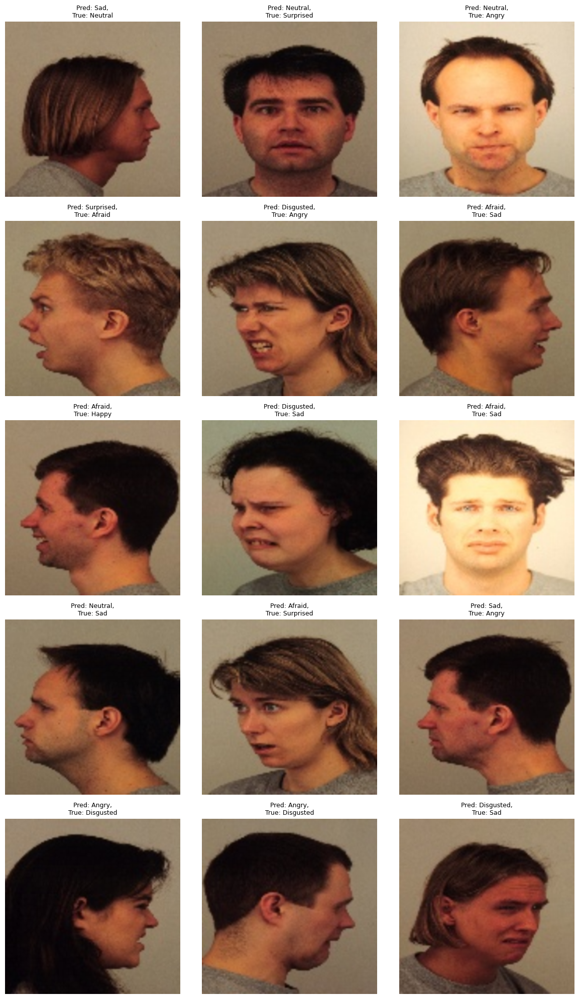




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531, 0.9183673469387756]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.50it/s]


train Loss: 1.8490 Acc: 0.2313


100%|██████████| 16/16 [00:01<00:00, 14.58it/s]


val Loss: 1.5315 Acc: 0.3980

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 1.2227 Acc: 0.5109


100%|██████████| 16/16 [00:01<00:00, 14.95it/s]


val Loss: 0.8909 Acc: 0.6571

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.7750 Acc: 0.7043


100%|██████████| 16/16 [00:01<00:00, 14.45it/s]


val Loss: 0.7232 Acc: 0.7082

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.5627 Acc: 0.7916


100%|██████████| 16/16 [00:01<00:00, 14.83it/s]


val Loss: 0.4886 Acc: 0.8265

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.4410 Acc: 0.8383


100%|██████████| 16/16 [00:01<00:00, 14.78it/s]


val Loss: 0.4066 Acc: 0.8388

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.2390 Acc: 0.9181


100%|██████████| 16/16 [00:01<00:00, 13.56it/s]


val Loss: 0.3046 Acc: 0.8837

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.2032 Acc: 0.9302


100%|██████████| 16/16 [00:01<00:00, 14.68it/s]


val Loss: 0.3008 Acc: 0.8857

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1829 Acc: 0.9383


100%|██████████| 16/16 [00:01<00:00, 14.04it/s]


val Loss: 0.3034 Acc: 0.8898

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1653 Acc: 0.9422


100%|██████████| 16/16 [00:01<00:00, 14.39it/s]


val Loss: 0.2779 Acc: 0.9041

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.1625 Acc: 0.9465


100%|██████████| 16/16 [00:01<00:00, 14.92it/s]


val Loss: 0.2862 Acc: 0.8878

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1539 Acc: 0.9474


100%|██████████| 16/16 [00:01<00:00, 14.01it/s]


val Loss: 0.2727 Acc: 0.9020

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1277 Acc: 0.9594


100%|██████████| 16/16 [00:01<00:00, 14.35it/s]


val Loss: 0.2675 Acc: 0.9000

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1233 Acc: 0.9612


100%|██████████| 16/16 [00:01<00:00, 14.10it/s]


val Loss: 0.2659 Acc: 0.9061

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.1255 Acc: 0.9594


100%|██████████| 16/16 [00:01<00:00, 14.78it/s]


val Loss: 0.2675 Acc: 0.8959

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1262 Acc: 0.9615


100%|██████████| 16/16 [00:01<00:00, 14.84it/s]


val Loss: 0.2677 Acc: 0.8980

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.1190 Acc: 0.9624


100%|██████████| 16/16 [00:01<00:00, 14.98it/s]


val Loss: 0.2618 Acc: 0.8980

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1259 Acc: 0.9574


100%|██████████| 16/16 [00:01<00:00, 14.86it/s]


val Loss: 0.2646 Acc: 0.9061

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1200 Acc: 0.9596


100%|██████████| 16/16 [00:01<00:00, 14.04it/s]


val Loss: 0.2659 Acc: 0.9061

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1200 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 14.53it/s]


val Loss: 0.2666 Acc: 0.9041

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1215 Acc: 0.9626


100%|██████████| 16/16 [00:01<00:00, 14.84it/s]


val Loss: 0.2658 Acc: 0.9061

Training complete in 5m 44s
Best val Acc: 0.906122
Showing misclassified examples for fold 5...


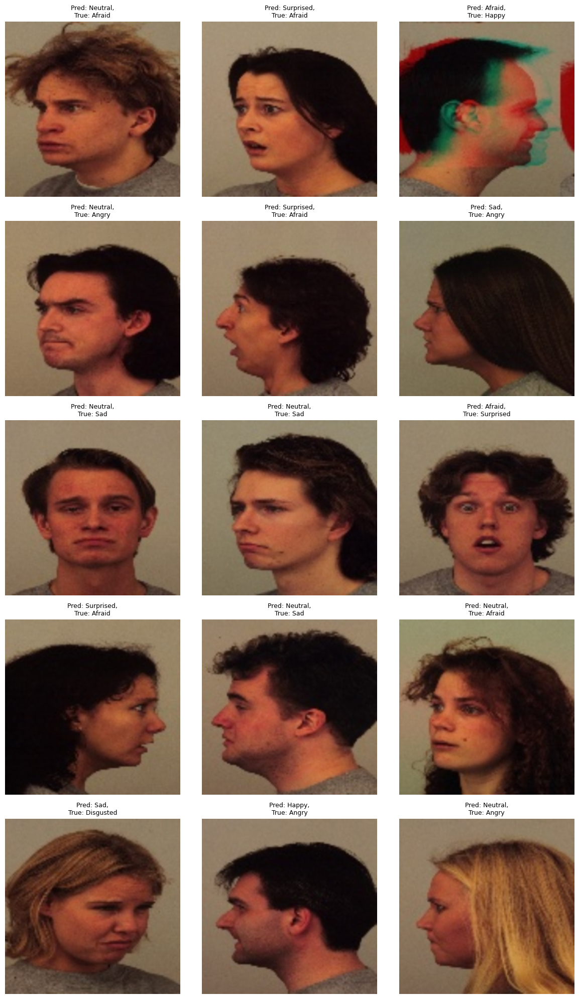




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531, 0.9183673469387756, 0.9061224489795919]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.45it/s]


train Loss: 1.8353 Acc: 0.2420


100%|██████████| 16/16 [00:01<00:00, 14.66it/s]


val Loss: 1.5073 Acc: 0.3796

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.48it/s]


train Loss: 1.1748 Acc: 0.5297


100%|██████████| 16/16 [00:01<00:00, 14.80it/s]


val Loss: 1.0322 Acc: 0.5735

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.7746 Acc: 0.6984


100%|██████████| 16/16 [00:01<00:00, 13.59it/s]


val Loss: 0.5525 Acc: 0.7918

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.5817 Acc: 0.7862


100%|██████████| 16/16 [00:01<00:00, 14.85it/s]


val Loss: 0.5463 Acc: 0.8184

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.4476 Acc: 0.8336


100%|██████████| 16/16 [00:01<00:00, 14.60it/s]


val Loss: 0.4535 Acc: 0.8408

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.2427 Acc: 0.9136


100%|██████████| 16/16 [00:01<00:00, 13.68it/s]


val Loss: 0.3493 Acc: 0.8878

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.2099 Acc: 0.9272


100%|██████████| 16/16 [00:01<00:00, 14.23it/s]


val Loss: 0.3492 Acc: 0.8816

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1864 Acc: 0.9358


100%|██████████| 16/16 [00:01<00:00, 14.27it/s]


val Loss: 0.3391 Acc: 0.8878

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1821 Acc: 0.9385


100%|██████████| 16/16 [00:01<00:00, 14.06it/s]


val Loss: 0.3197 Acc: 0.8918

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1586 Acc: 0.9426


100%|██████████| 16/16 [00:01<00:00, 14.96it/s]


val Loss: 0.3157 Acc: 0.8837

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1501 Acc: 0.9467


100%|██████████| 16/16 [00:01<00:00, 13.41it/s]


val Loss: 0.3189 Acc: 0.8939

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1351 Acc: 0.9551


100%|██████████| 16/16 [00:01<00:00, 14.41it/s]


val Loss: 0.3173 Acc: 0.8980

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1303 Acc: 0.9599


100%|██████████| 16/16 [00:01<00:00, 13.09it/s]


val Loss: 0.3154 Acc: 0.8980

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.46it/s]


train Loss: 0.1274 Acc: 0.9587


100%|██████████| 16/16 [00:01<00:00, 13.73it/s]


val Loss: 0.3126 Acc: 0.9020

Epoch 14/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.63it/s]


train Loss: 0.1193 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 14.70it/s]


val Loss: 0.3107 Acc: 0.9020

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.45it/s]


train Loss: 0.1295 Acc: 0.9576


100%|██████████| 16/16 [00:01<00:00, 14.60it/s]


val Loss: 0.3139 Acc: 0.9000

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1238 Acc: 0.9615


100%|██████████| 16/16 [00:01<00:00, 13.67it/s]


val Loss: 0.3106 Acc: 0.9020

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1288 Acc: 0.9576


100%|██████████| 16/16 [00:01<00:00, 13.98it/s]


val Loss: 0.3107 Acc: 0.9020

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.1221 Acc: 0.9619


100%|██████████| 16/16 [00:01<00:00, 14.09it/s]


val Loss: 0.3106 Acc: 0.9020

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1243 Acc: 0.9608


100%|██████████| 16/16 [00:01<00:00, 14.95it/s]


val Loss: 0.3104 Acc: 0.9020

Training complete in 5m 46s
Best val Acc: 0.902041
Showing misclassified examples for fold 6...


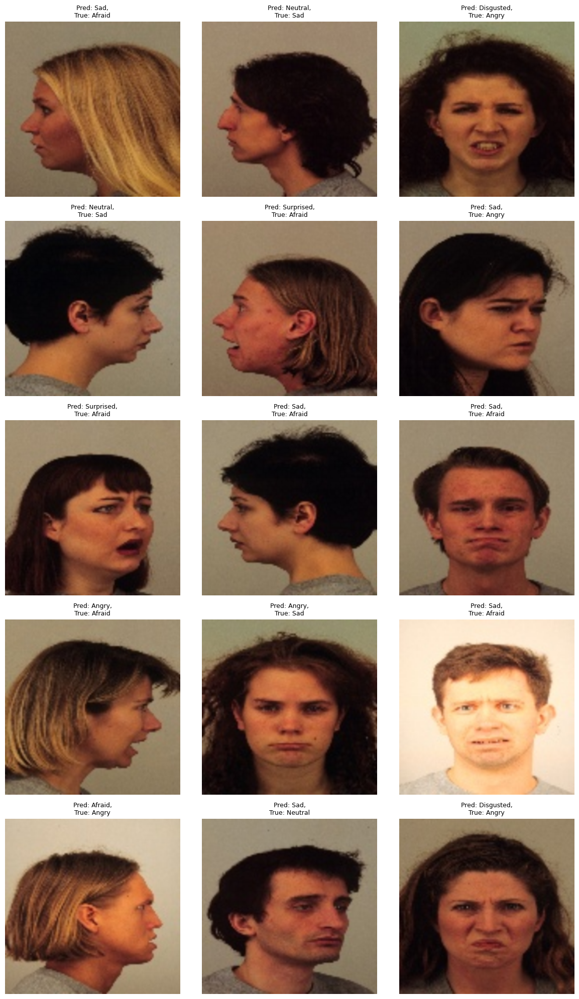




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531, 0.9183673469387756, 0.9061224489795919, 0.9020408163265307]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 1.7893 Acc: 0.2683


100%|██████████| 16/16 [00:01<00:00, 14.79it/s]


val Loss: 1.4224 Acc: 0.4531

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.50it/s]


train Loss: 1.0782 Acc: 0.5834


100%|██████████| 16/16 [00:01<00:00, 14.47it/s]


val Loss: 0.7811 Acc: 0.7000

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.53it/s]


train Loss: 0.7382 Acc: 0.7122


100%|██████████| 16/16 [00:01<00:00, 14.64it/s]


val Loss: 0.8084 Acc: 0.6878

Epoch 3/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.5590 Acc: 0.7966


100%|██████████| 16/16 [00:01<00:00, 14.70it/s]


val Loss: 0.5484 Acc: 0.7939

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.4340 Acc: 0.8415


100%|██████████| 16/16 [00:01<00:00, 13.05it/s]


val Loss: 0.5162 Acc: 0.8184

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.2326 Acc: 0.9222


100%|██████████| 16/16 [00:01<00:00, 14.67it/s]


val Loss: 0.3401 Acc: 0.8673

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.43it/s]


train Loss: 0.1943 Acc: 0.9358


100%|██████████| 16/16 [00:01<00:00, 14.66it/s]


val Loss: 0.3285 Acc: 0.8694

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1781 Acc: 0.9410


100%|██████████| 16/16 [00:01<00:00, 14.22it/s]


val Loss: 0.3472 Acc: 0.8612

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1680 Acc: 0.9435


100%|██████████| 16/16 [00:01<00:00, 14.85it/s]


val Loss: 0.3247 Acc: 0.8857

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.49it/s]


train Loss: 0.1469 Acc: 0.9510


100%|██████████| 16/16 [00:01<00:00, 13.05it/s]


val Loss: 0.3039 Acc: 0.8898

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.52it/s]


train Loss: 0.1415 Acc: 0.9515


100%|██████████| 16/16 [00:01<00:00, 14.45it/s]


val Loss: 0.3032 Acc: 0.8980

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.46it/s]


train Loss: 0.1283 Acc: 0.9587


100%|██████████| 16/16 [00:01<00:00, 14.09it/s]


val Loss: 0.3101 Acc: 0.8939

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1229 Acc: 0.9626


100%|██████████| 16/16 [00:01<00:00, 14.54it/s]


val Loss: 0.3045 Acc: 0.8939

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1311 Acc: 0.9562


100%|██████████| 16/16 [00:01<00:00, 14.71it/s]


val Loss: 0.3097 Acc: 0.8898

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1219 Acc: 0.9610


100%|██████████| 16/16 [00:01<00:00, 14.18it/s]


val Loss: 0.3042 Acc: 0.8939

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.48it/s]


train Loss: 0.1227 Acc: 0.9612


100%|██████████| 16/16 [00:01<00:00, 14.77it/s]


val Loss: 0.3109 Acc: 0.8898

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1146 Acc: 0.9642


100%|██████████| 16/16 [00:01<00:00, 13.71it/s]


val Loss: 0.3022 Acc: 0.8918

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1144 Acc: 0.9642


100%|██████████| 16/16 [00:01<00:00, 14.72it/s]


val Loss: 0.3039 Acc: 0.8959

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1102 Acc: 0.9673


100%|██████████| 16/16 [00:01<00:00, 14.17it/s]


val Loss: 0.3040 Acc: 0.8959

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.50it/s]


train Loss: 0.1174 Acc: 0.9637


100%|██████████| 16/16 [00:01<00:00, 14.60it/s]


val Loss: 0.3052 Acc: 0.8939

Training complete in 5m 46s
Best val Acc: 0.897959
Showing misclassified examples for fold 7...


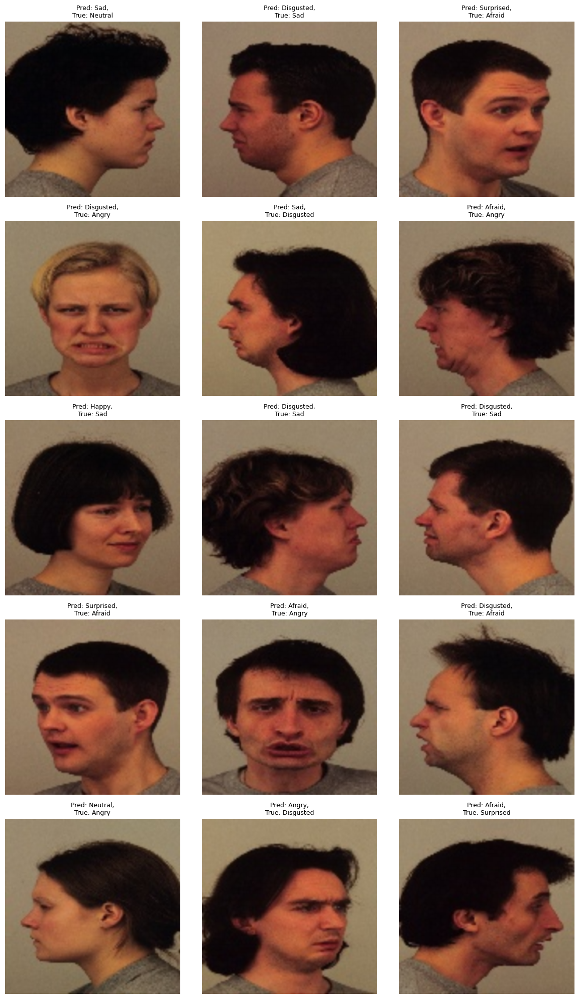




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531, 0.9183673469387756, 0.9061224489795919, 0.9020408163265307, 0.8979591836734695]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.43it/s]


train Loss: 1.8855 Acc: 0.2277


100%|██████████| 16/16 [00:01<00:00, 13.52it/s]


val Loss: 1.6583 Acc: 0.3449

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 1.2972 Acc: 0.4905


100%|██████████| 16/16 [00:01<00:00, 14.36it/s]


val Loss: 0.8547 Acc: 0.6490

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.8037 Acc: 0.6898


100%|██████████| 16/16 [00:01<00:00, 14.50it/s]


val Loss: 0.5611 Acc: 0.7796

Epoch 3/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.63it/s]


train Loss: 0.5709 Acc: 0.7909


100%|██████████| 16/16 [00:01<00:00, 13.89it/s]


val Loss: 0.4996 Acc: 0.8061

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.4537 Acc: 0.8345


100%|██████████| 16/16 [00:01<00:00, 14.83it/s]


val Loss: 0.3617 Acc: 0.8571

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.2453 Acc: 0.9141


100%|██████████| 16/16 [00:01<00:00, 13.98it/s]


val Loss: 0.3152 Acc: 0.8898

Epoch 6/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.66it/s]


train Loss: 0.2166 Acc: 0.9268


100%|██████████| 16/16 [00:01<00:00, 14.91it/s]


val Loss: 0.3036 Acc: 0.8939

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1856 Acc: 0.9376


100%|██████████| 16/16 [00:01<00:00, 14.22it/s]


val Loss: 0.2937 Acc: 0.8918

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1827 Acc: 0.9329


100%|██████████| 16/16 [00:01<00:00, 14.55it/s]


val Loss: 0.2797 Acc: 0.8939

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1524 Acc: 0.9465


100%|██████████| 16/16 [00:01<00:00, 14.00it/s]


val Loss: 0.2626 Acc: 0.8959

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1416 Acc: 0.9531


100%|██████████| 16/16 [00:01<00:00, 14.66it/s]


val Loss: 0.2539 Acc: 0.9122

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.51it/s]


train Loss: 0.1351 Acc: 0.9556


100%|██████████| 16/16 [00:01<00:00, 14.20it/s]


val Loss: 0.2526 Acc: 0.9020

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.1280 Acc: 0.9603


100%|██████████| 16/16 [00:01<00:00, 14.94it/s]


val Loss: 0.2497 Acc: 0.9041

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1237 Acc: 0.9612


100%|██████████| 16/16 [00:01<00:00, 14.06it/s]


val Loss: 0.2504 Acc: 0.9041

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1275 Acc: 0.9580


100%|██████████| 16/16 [00:01<00:00, 14.88it/s]


val Loss: 0.2478 Acc: 0.9061

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.1274 Acc: 0.9569


100%|██████████| 16/16 [00:01<00:00, 14.17it/s]


val Loss: 0.2491 Acc: 0.9061

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1278 Acc: 0.9596


100%|██████████| 16/16 [00:01<00:00, 14.43it/s]


val Loss: 0.2511 Acc: 0.9061

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.1209 Acc: 0.9605


100%|██████████| 16/16 [00:01<00:00, 14.14it/s]


val Loss: 0.2501 Acc: 0.9061

Epoch 18/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.66it/s]


train Loss: 0.1312 Acc: 0.9549


100%|██████████| 16/16 [00:01<00:00, 14.57it/s]


val Loss: 0.2494 Acc: 0.9061

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1214 Acc: 0.9610


100%|██████████| 16/16 [00:01<00:00, 13.88it/s]


val Loss: 0.2488 Acc: 0.9061

Training complete in 5m 44s
Best val Acc: 0.912245
Showing misclassified examples for fold 8...


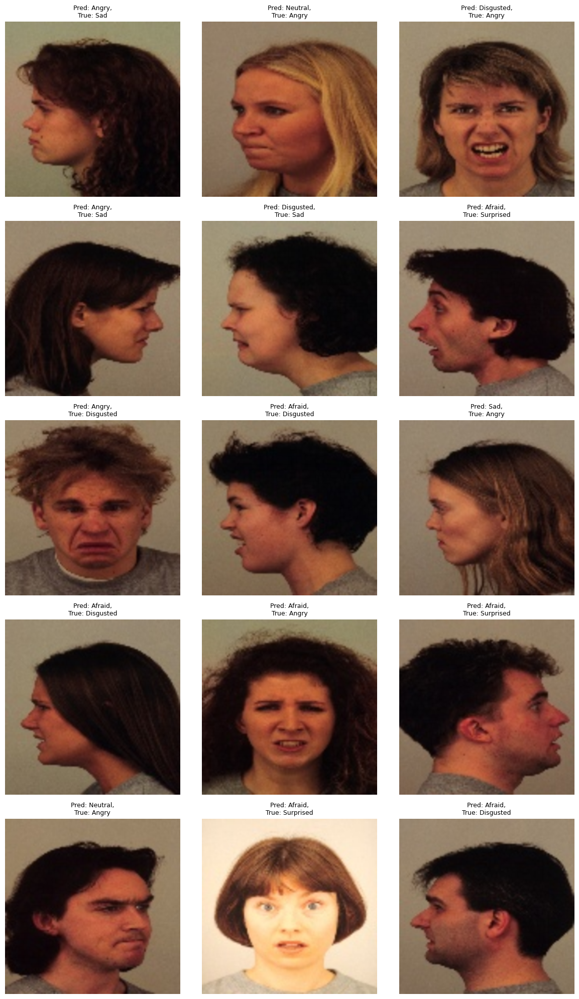




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531, 0.9183673469387756, 0.9061224489795919, 0.9020408163265307, 0.8979591836734695, 0.9122448979591837]



Epoch 0/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.46it/s]


train Loss: 1.8100 Acc: 0.2501


100%|██████████| 16/16 [00:01<00:00, 14.62it/s]


val Loss: 1.3923 Acc: 0.4306

Epoch 1/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 1.1394 Acc: 0.5438


100%|██████████| 16/16 [00:01<00:00, 14.79it/s]


val Loss: 0.8015 Acc: 0.6755

Epoch 2/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.7139 Acc: 0.7259


100%|██████████| 16/16 [00:01<00:00, 14.58it/s]


val Loss: 0.6287 Acc: 0.7755

Epoch 3/19
----------


100%|██████████| 138/138 [00:15<00:00,  8.65it/s]


train Loss: 0.5381 Acc: 0.8048


100%|██████████| 16/16 [00:01<00:00, 14.79it/s]


val Loss: 0.4933 Acc: 0.8224

Epoch 4/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.4005 Acc: 0.8569


100%|██████████| 16/16 [00:01<00:00, 14.84it/s]


val Loss: 0.4735 Acc: 0.8367

Epoch 5/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.2241 Acc: 0.9181


100%|██████████| 16/16 [00:01<00:00, 14.51it/s]


val Loss: 0.3104 Acc: 0.9020

Epoch 6/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.59it/s]


train Loss: 0.1902 Acc: 0.9361


100%|██████████| 16/16 [00:01<00:00, 14.50it/s]


val Loss: 0.3158 Acc: 0.8980

Epoch 7/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.60it/s]


train Loss: 0.1680 Acc: 0.9392


100%|██████████| 16/16 [00:01<00:00, 14.75it/s]


val Loss: 0.3132 Acc: 0.9122

Epoch 8/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1600 Acc: 0.9456


100%|██████████| 16/16 [00:01<00:00, 14.76it/s]


val Loss: 0.2827 Acc: 0.9143

Epoch 9/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.57it/s]


train Loss: 0.1380 Acc: 0.9526


100%|██████████| 16/16 [00:01<00:00, 13.87it/s]


val Loss: 0.2901 Acc: 0.9061

Epoch 10/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.54it/s]


train Loss: 0.1354 Acc: 0.9526


100%|██████████| 16/16 [00:01<00:00, 14.27it/s]


val Loss: 0.2788 Acc: 0.9163

Epoch 11/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.62it/s]


train Loss: 0.1197 Acc: 0.9583


100%|██████████| 16/16 [00:01<00:00, 13.89it/s]


val Loss: 0.2762 Acc: 0.9204

Epoch 12/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1149 Acc: 0.9628


100%|██████████| 16/16 [00:01<00:00, 14.72it/s]


val Loss: 0.2748 Acc: 0.9184

Epoch 13/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1174 Acc: 0.9590


100%|██████████| 16/16 [00:01<00:00, 14.34it/s]


val Loss: 0.2751 Acc: 0.9163

Epoch 14/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1152 Acc: 0.9630


100%|██████████| 16/16 [00:01<00:00, 14.84it/s]


val Loss: 0.2735 Acc: 0.9204

Epoch 15/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.61it/s]


train Loss: 0.1117 Acc: 0.9605


100%|██████████| 16/16 [00:01<00:00, 14.88it/s]


val Loss: 0.2782 Acc: 0.9184

Epoch 16/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.56it/s]


train Loss: 0.1141 Acc: 0.9610


100%|██████████| 16/16 [00:01<00:00, 14.58it/s]


val Loss: 0.2748 Acc: 0.9224

Epoch 17/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.55it/s]


train Loss: 0.1096 Acc: 0.9664


100%|██████████| 16/16 [00:01<00:00, 14.44it/s]


val Loss: 0.2746 Acc: 0.9224

Epoch 18/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.47it/s]


train Loss: 0.1055 Acc: 0.9635


100%|██████████| 16/16 [00:01<00:00, 14.55it/s]


val Loss: 0.2750 Acc: 0.9224

Epoch 19/19
----------


100%|██████████| 138/138 [00:16<00:00,  8.58it/s]


train Loss: 0.1003 Acc: 0.9673


100%|██████████| 16/16 [00:01<00:00, 14.36it/s]


val Loss: 0.2751 Acc: 0.9224

Training complete in 5m 44s
Best val Acc: 0.922449
Showing misclassified examples for fold 9...


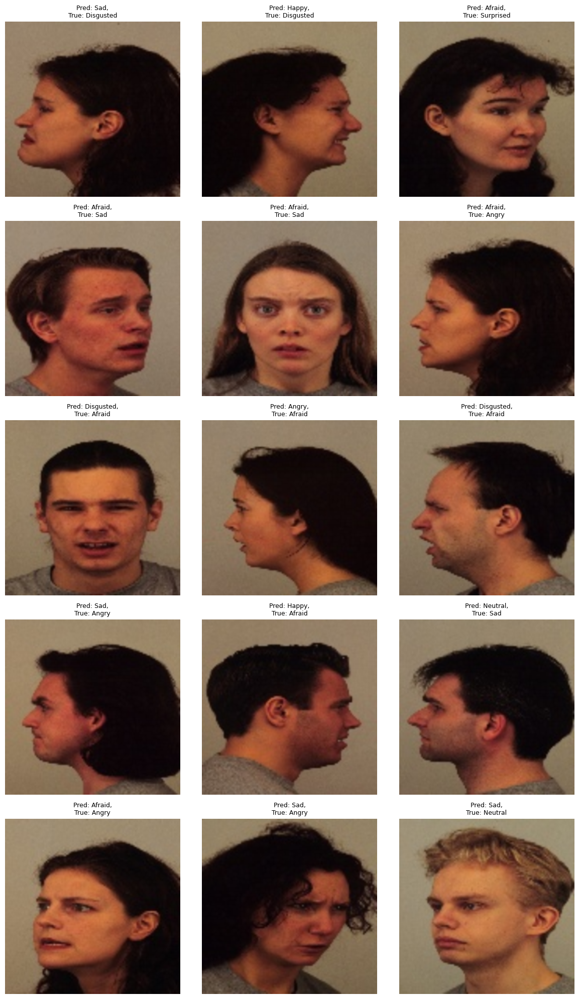




------------------------------------
 Accuracies  [0.916326530612245, 0.8979591836734695, 0.9122448979591837, 0.9102040816326531, 0.9183673469387756, 0.9061224489795919, 0.9020408163265307, 0.8979591836734695, 0.9122448979591837, 0.9224489795918368]





In [12]:
import torch
import os
import numpy as np
import shutil
from torch import nn, optim
from torch.optim import lr_scheduler
from torchvision import models
from torch.utils.tensorboard import SummaryWriter

accuracies = []
index = list(np.random.permutation(4900))

best_overall_acc = 0.0
best_model_path = ""

for i in range(10):
    idx = {
        'val': index[490 * i:490 * (i + 1)],
        'train': index[:i * 490] + index[((i + 1) * 490):]
    }

    dataloaders = {
        x: torch.utils.data.DataLoader(
            KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
            batch_size=32,
            shuffle=True
        )
        for x in ['train', 'val']
    }

    model_ft = models.vgg16(weights='IMAGENET1K_V1')
    num_ftrs = model_ft.classifier[6].in_features
    model_ft.classifier[6] = nn.Linear(num_ftrs, class_names)
    model_ft = model_ft.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=6, gamma=0.1)

    logdir = f'./logs/VGG-16_kfold_{i}'
    os.makedirs(logdir, exist_ok=True)
    writer = SummaryWriter(logdir)

    os.makedirs('saved', exist_ok=True)

    model_ft, best_acc = train_model(
        model_ft,
        criterion,
        optimizer_ft,
        exp_lr_scheduler,
        dataloaders,
        writer,
        i,
        num_epochs=20
    )

    model_path = f'saved/model_fold_{i}.pt'
    torch.save(model_ft.state_dict(), model_path)

    if best_acc > best_overall_acc:
        best_overall_acc = best_acc
        best_model_path = model_path

    print(f"Showing misclassified examples for fold {i}...")
    visualize_model_misclassified(
        model=model_ft,
        dataloader=dataloaders['val'],
        class_names={
            0: "Afraid", 1: "Angry", 2: "Disgusted",
            3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"
        },
        save_dir=f'misclassified/fold_{i}',
        num_images=15,
    )

    accuracies.append(float(best_acc.cpu().numpy()))
    print("\n\n\n------------------------------------\n Accuracies ", accuracies)
    print("\n\n")


    os.makedirs('best_model', exist_ok=True)
    shutil.copy(best_model_path, 'best_model/VGG16_best_model.pt')



In [13]:
from google.colab import files

!zip -r VGG_16_112x112_logs_best_model.zip logs misclassified best_model
files.download('VGG_16_112x112_logs_best_model.zip')

  adding: logs/ (stored 0%)
  adding: logs/VGG-16_kfold_0/ (stored 0%)
  adding: logs/VGG-16_kfold_0/events.out.tfevents.1744962927.f20b20750d8e.3234.0 (deflated 61%)
  adding: logs/VGG-16_kfold_0/events.out.tfevents.1744962805.f20b20750d8e (deflated 22%)
  adding: logs/VGG-16_kfold_8/ (stored 0%)
  adding: logs/VGG-16_kfold_8/events.out.tfevents.1744965739.f20b20750d8e.3234.8 (deflated 62%)
  adding: logs/VGG-16_kfold_4/ (stored 0%)
  adding: logs/VGG-16_kfold_4/events.out.tfevents.1744964329.f20b20750d8e.3234.4 (deflated 61%)
  adding: logs/VGG-16_kfold_7/ (stored 0%)
  adding: logs/VGG-16_kfold_7/events.out.tfevents.1744965383.f20b20750d8e.3234.7 (deflated 61%)
  adding: logs/VGG-16_kfold_3/ (stored 0%)
  adding: logs/VGG-16_kfold_3/events.out.tfevents.1744963976.f20b20750d8e.3234.3 (deflated 62%)
  adding: logs/VGG-16_kfold_6/ (stored 0%)
  adding: logs/VGG-16_kfold_6/events.out.tfevents.1744965031.f20b20750d8e.3234.6 (deflated 62%)
  adding: logs/VGG-16_kfold_5/ (stored 0%)
  addi

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>